# Analyzing neural spike data

Today, we'll get to analyzing spike data. In particular, we'll deal with estimating firing rates, which are typically the variables of interest. Once we have a good firing rate estimate, we often want to know how such rates are related to behavior, either evoked by it (as in sensory areas) or driving it (as in the motor system).

We'll begin with where we left off in the [last section](exploring-spike-data):

/Users/jmxp/anaconda3/lib/python3.8/site-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1bsqBXmV0SrMwycyRR0jY5gyw7wqjYQI_
To: /Users/jmxp/code/neural-data-analysis-book/introduction_to_neural_data_analysis/point_process/fef_spikes.mat
100%|████████████████████████████████████████| 111k/111k [00:00<00:00, 7.08MB/s]
Number of trials: 52
Number of units: 3
Number of time points: 550
True
True
All tests passed
All tests passed for t_min: 0, t_max: 100
All tests passed for t_min: 0, t_max: 250
All tests passed for t_min: 0, t_max: 550
All tests passed for t_min: 100, t_max: 250
All tests passed for t_min: 100, t_max: 550
All tests passed for t_min: 250, t_max: 550
All tests passed for t_min: 0, t_max: 100
All tests passed for t_min: 0, t_max: 250
All tests passed for t_min: 0, t_max: 550
All tests passed

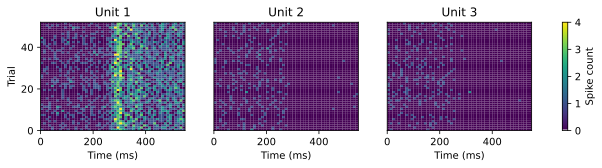

In [5]:
%run exploring_spike_data.ipynb

## Estimating mean firing rates

As we [saw before](psth-section), the simplest method for estimating a firing rate for a cell is to average its responses over multiple trials. Here, we'll practice that on real data.

```{admonition} Exercise
1. Using the spike histogram data, compute the average spike count in each bin across trials for unit 1.
1. Convert this from a mean spike count per bin to a mean firing rate.
1. Plot the result as a function of time.
```

### Solutions:

In [6]:
# 1. Average spike counts for unit 1

# Recall that spk_bin is of shape n_timepoints/bin_width X n_trials X n_units.
# Let's use 1ms bins, and average across axis 1 (remember, Python follows zero-indexing)
bin_width = 1
spk_bin = spikes_to_bin_varwidth(spikes, t_min=0, t_max=n_timepoints, bin_width=bin_width)
avg_spk_count = np.mean(spk_bin[:,:,0], axis=1)

In [7]:
# 2. Convert this from a mean spike count per bin to a mean firing rate.

avg_rate = avg_spk_count/(bin_width*1e-3) # bin_width is ms, need to convert to seconds

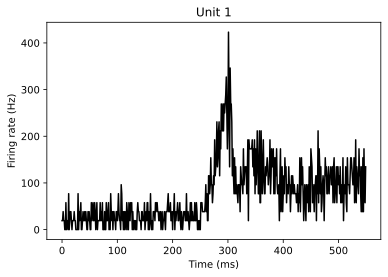

In [8]:
# 3. Plot the result as a function of time.

plt.figure()
t = np.arange(0, n_timepoints, bin_width)
plt.plot(t, avg_rate)
plt.ylabel("Firing rate (Hz)")
plt.xlabel("Time (ms)")
plt.title("Unit 1");

### Smoothing

Typically, even with trial averaging, firing rates have a lot of noise. Under the assumption that rates are not changing drastically from one bin to the next, we can often get a more interpretable result by smoothing.

The most common method of smoothing is calculating a moving average, which we can do [using NumPy's filtering commands](https://scipy-cookbook.readthedocs.io/items/SignalSmooth.html). This demo is more complicated than you might need, so just focus on the key line, which involves [`numpy.convolve`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.convolve.html).

```{admonition} Exercise
1. Smooth the trial-averaged firing rate over a 20ms window.
1. Plot this as a function of time on the same plot as the unsmoothed average.
```

In [9]:
# 1. Smooth the trial-averaged firing rate over a 20ms window.

window_len = 20
w = np.ones(window_len)
y = np.convolve(w/w.sum(), avg_rate, mode='same')

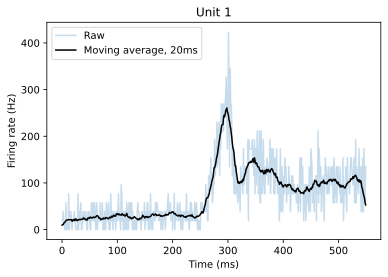

In [10]:
# 2. Plot smoothed and unsmoothed together.

plt.plot(t, avg_rate, alpha=0.25)
plt.plot(y, color='black')
plt.ylabel("Firing rate (Hz)")
plt.xlabel("Time (ms)")
plt.title("Unit 1")
plt.legend(["Raw", "Moving average, 20ms"]);